In [ ]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


# sift = cv2.xfeatures2d.SIFT_create()
sift = cv2.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1

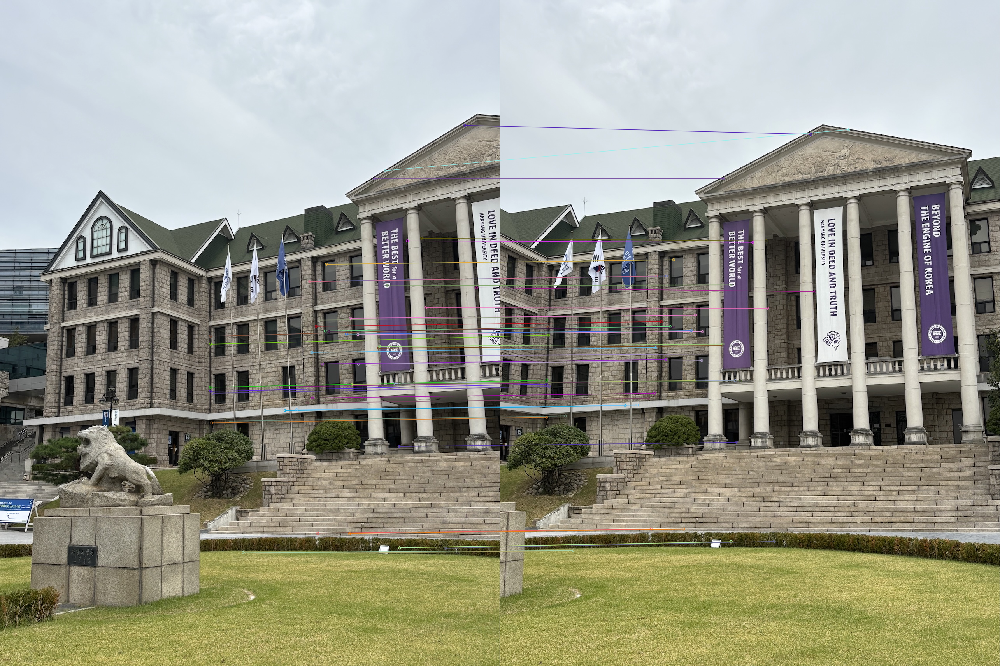

In [111]:

sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

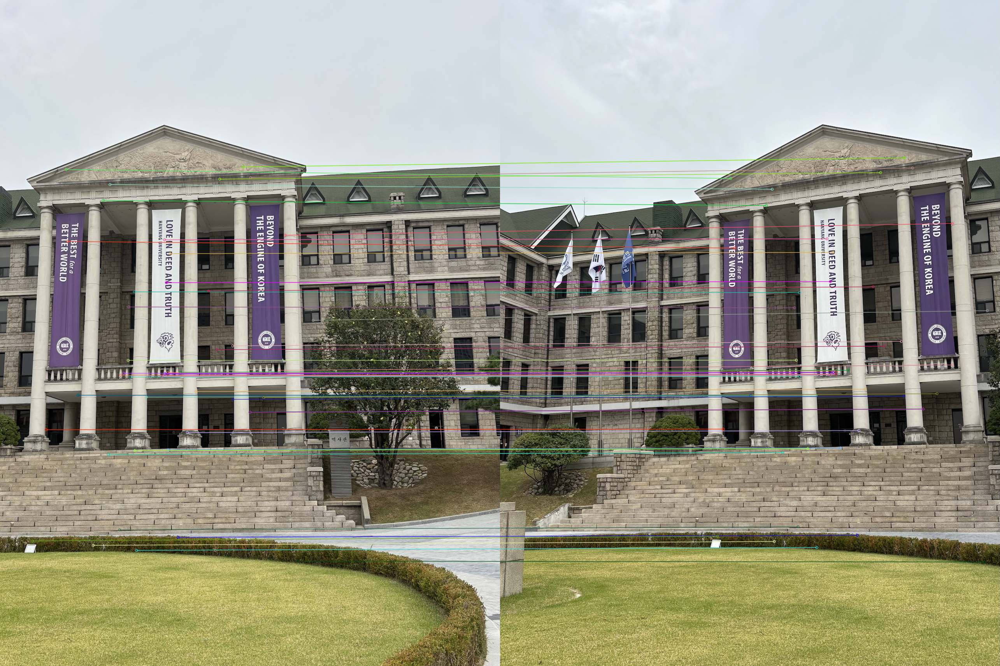

In [112]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[2], kps[2], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [ ]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = H @ before
after /= after[2, :] 
after = after[:2, :]
after = np.round(after, 0).astype(int)


for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = H @ before
after /= after[2, :]
after = after[:2, :]
after = after.astype(int)
after[0] += width

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
result[0:height, width:width*2] = images[1]

In [ ]:
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

implement

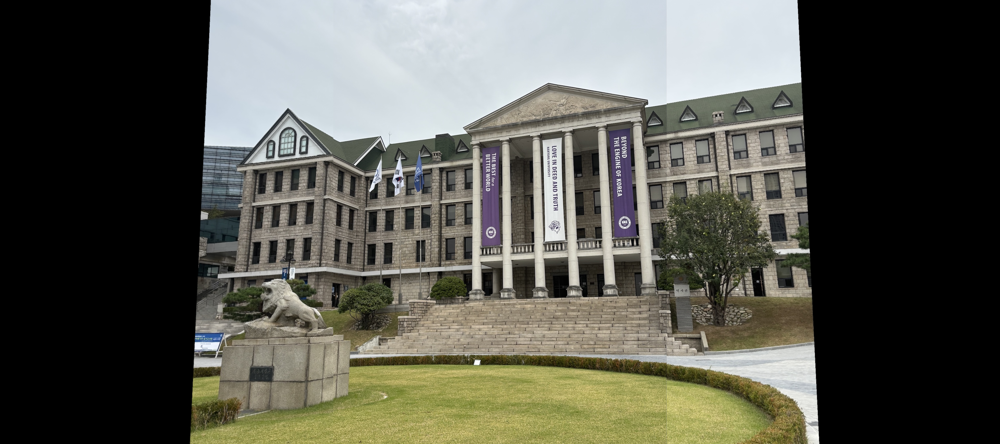

In [2]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


# sift = cv2.xfeatures2d.SIFT_create()
sift = cv2.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1


height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src1 = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst1 = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H1, status = cv2.findHomography(src1, dst1, cv2.RANSAC, 5.0)
# print("H1 : \n", H1)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

mask1 = np.full_like(result[:,:,0], 255)

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = H1 @ before
after /= after[2, :] 
after = after[:2, :]
after = np.round(after, 0).astype(int)

# print("after 1:\n", after)

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]
    mask1[pt2[1], width + pt2[0]] = 0


# Stitch image0 to image1
src2 = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst2 = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H2, status = cv2.findHomography(src2, dst2, cv2.RANSAC, 5.0)

# print("H2 : \n", H2)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = H2 @ before
after /= after[2, :]
after = after[:2, :]
after = after.astype(int)
after[0] += width

# print("after 2:\n", after)

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
    mask1[pt2[1], pt2[0]] = 0
    
result[0:height, width:width * 2] = images[1]
mask = np.zeros((height, width * 3), dtype=np.uint8)


mask[0:height, width:width * 2] = 0 


src = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype=np.float32).reshape(-1, 1, 2)
dst_2 = cv2.perspectiveTransform(src, H1)
dst_2[:, :, 0] += width  

cv2.fillConvexPoly(mask, dst_2.astype(np.int32), 255)

dst_0 = cv2.perspectiveTransform(src, H2)
dst_0[:, :, 0] += width  
cv2.fillConvexPoly(mask, dst_0.astype(np.int32), 255)

from PIL import Image
mask = np.where(mask > 0, 255, 0).astype(np.uint8)
mask[0:height, width:width * 2] = 0  
# mask[0:height, width:width * 2] = 0  
# Image.fromarray(cv2.cvtColor(mask, cv2.COLOR_BGR2RGB))

mask_fin = mask + mask1
mask_fin = mask_fin - np.full_like(mask, 255)
mask_fin[0:height, width:width * 2] = 255 

# Image.fromarray(cv2.cvtColor(mask_fin, cv2.COLOR_BGR2RGB))
result_filled = cv2.inpaint(result, mask_fin, inpaintRadius=3, flags=cv2.INPAINT_TELEA)
result_filled[0:height, width:width * 2] = images[1]

from PIL import Image
Image.fromarray(cv2.cvtColor(result_filled, cv2.COLOR_BGR2RGB))


blending

In [5]:
import numpy as np
import cv2

def calculate_average_brightness(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  
    return np.mean(gray)

def adjust_to_target_brightness(image, target_brightness):
    current_brightness = calculate_average_brightness(image)
    adjustment_factor = target_brightness / current_brightness
    adjusted = image.astype(np.float32) * adjustment_factor
    return np.clip(adjusted, 0, 255).astype(np.uint8)

brightness_values = [calculate_average_brightness(img) for img in images]
target_brightness = np.mean(brightness_values) 

images_adjusted = [adjust_to_target_brightness(img, target_brightness) for img in images]


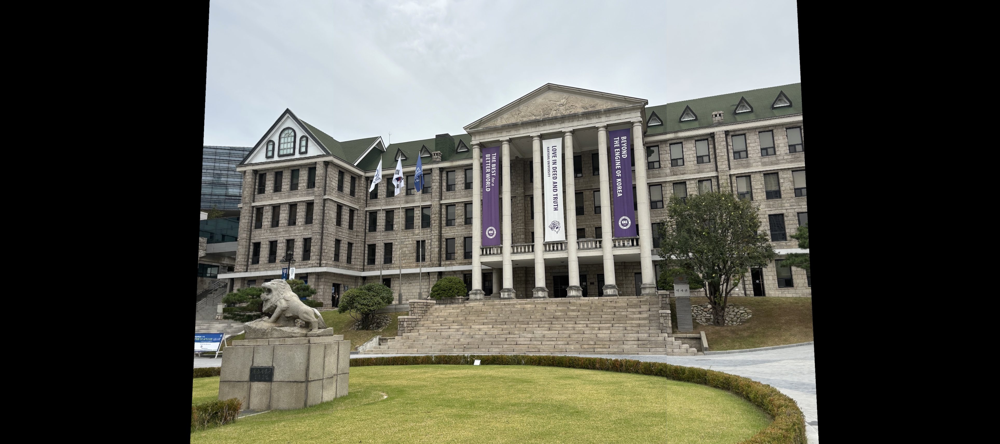

In [12]:
import numpy as np
import cv2

images = images_adjusted
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


# sift = cv2.xfeatures2d.SIFT_create()
sift = cv2.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1


height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src1 = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst1 = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H1, status = cv2.findHomography(src1, dst1, cv2.RANSAC, 5.0)
# print("H1 : \n", H1)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

mask1 = np.full_like(result[:,:,0], 255)

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = H1 @ before
after /= after[2, :] 
after = after[:2, :]
after = np.round(after, 0).astype(int)

# print("after 1:\n", after)

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]
    mask1[pt2[1], width + pt2[0]] = 0


# Stitch image0 to image1
src2 = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst2 = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H2, status = cv2.findHomography(src2, dst2, cv2.RANSAC, 5.0)

# print("H2 : \n", H2)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = H2 @ before
after /= after[2, :]
after = after[:2, :]
after = after.astype(int)
after[0] += width

# print("after 2:\n", after)

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
    mask1[pt2[1], pt2[0]] = 0
    
result[0:height, width:width * 2] = images[1]
mask = np.zeros((height, width * 3), dtype=np.uint8)

mask[0:height, width:width * 2] = 0  

src = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype=np.float32).reshape(-1, 1, 2)
dst_2 = cv2.perspectiveTransform(src, H1)
dst_2[:, :, 0] += width 

cv2.fillConvexPoly(mask, dst_2.astype(np.int32), 255)


dst_0 = cv2.perspectiveTransform(src, H2)
dst_0[:, :, 0] += width 

cv2.fillConvexPoly(mask, dst_0.astype(np.int32), 255)

from PIL import Image
mask = np.where(mask > 0, 255, 0).astype(np.uint8)
mask[0:height, width:width * 2] = 0 
# mask[0:height, width:width * 2] = 0  
# Image.fromarray(cv2.cvtColor(mask, cv2.COLOR_BGR2RGB))

mask_fin = mask + mask1
mask_fin = mask_fin - np.full_like(mask, 255)
mask_fin[0:height, width:width * 2] = 255  

# Image.fromarray(cv2.cvtColor(mask_fin, cv2.COLOR_BGR2RGB))
result_filled = cv2.inpaint(result, mask_fin, inpaintRadius=3, flags=cv2.INPAINT_TELEA)
result_filled[0:height, width:width * 2] = images[1]

from PIL import Image
Image.fromarray(cv2.cvtColor(result_filled, cv2.COLOR_BGR2RGB))


Crop

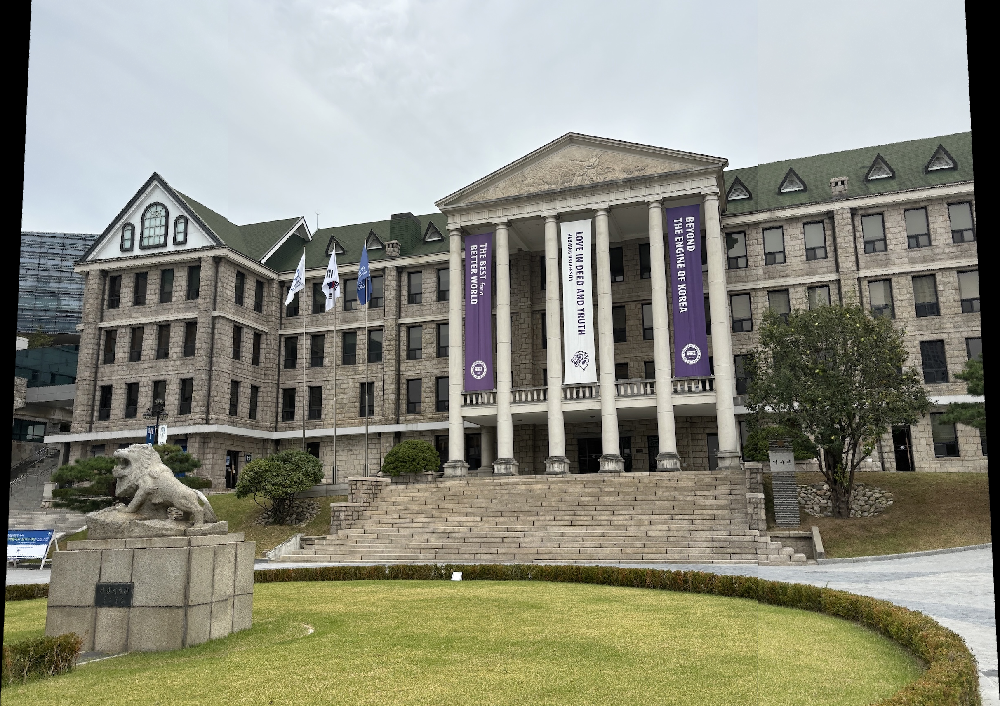

In [14]:
import numpy as np
import cv2

def crop_to_trapezoid(image):
    """
    Remove all black borders and crop the image to the non-black trapezoidal region.
    Args:
        image: Input image with potential black borders.
    Returns:
        Cropped image in trapezoidal shape.
    """
    # Convert to grayscale for border detection
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Create a binary mask of non-black areas
    _, binary = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)

    # Find contours of the non-black areas
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Find the largest contour (assuming it is the main content)
    contour = max(contours, key=cv2.contourArea)

    # Create a mask for the largest contour
    mask = np.zeros_like(gray)
    cv2.drawContours(mask, [contour], -1, 255, thickness=cv2.FILLED)

    # Apply the mask to the original image
    result = cv2.bitwise_and(image, image, mask=mask)

    # Crop the bounding region of the contour
    x, y, w, h = cv2.boundingRect(contour)
    cropped = result[y:y+h, x:x+w]

    return cropped

# Apply the function to the result image
final_result = crop_to_trapezoid(result_filled)

# Display the final result
from PIL import Image
Image.fromarray(cv2.cvtColor(final_result, cv2.COLOR_BGR2RGB))
